# Manufactoring of ultrasonography machine- color doppler

# About Dataset

Manufacturing process feature selection and categorization

Content
Abstract: Data from a manufacturing process

Data Set Characteristics: Multivariate
Number of Instances: more than 1500
Area: Medical/electronics
Attribute Characteristics: Real
Number of Attributes: more than 550
Associated Tasks: Classification, Causal-Discovery

A complex modern Ultrasound manufacturing, assembly and testing process is normally under consistent surveillance via the monitoring of signals/variables collected from sensors and or
process measurement points. 
Almost all of these signals are equally valuable in a specific monitoring, Assembly & testing system. 
The measured signals contain a combination of useful information, irrelevant information as well as noise. It is often the case that useful information is buried in the latter two. 
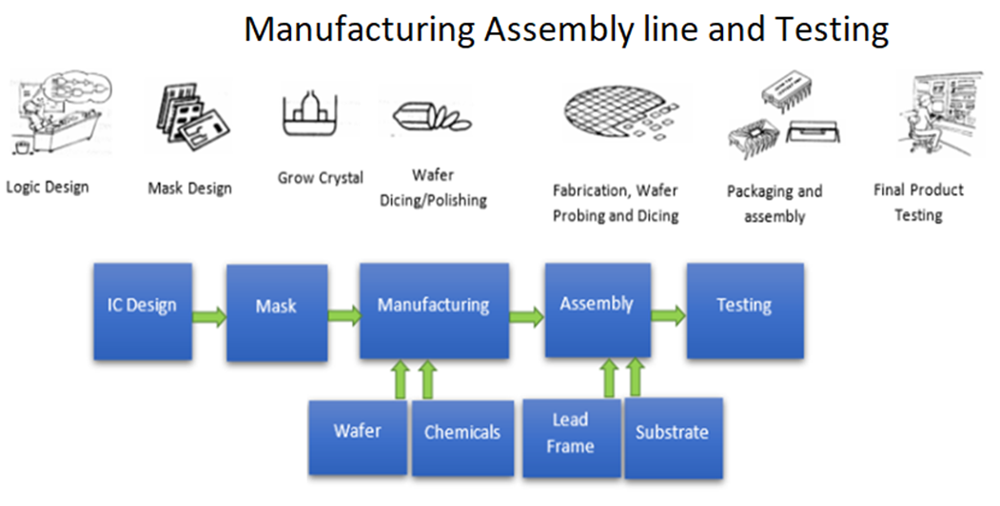

 
A large number of vendors, suppliers are involving in the manufacturing and assembly of the devices.
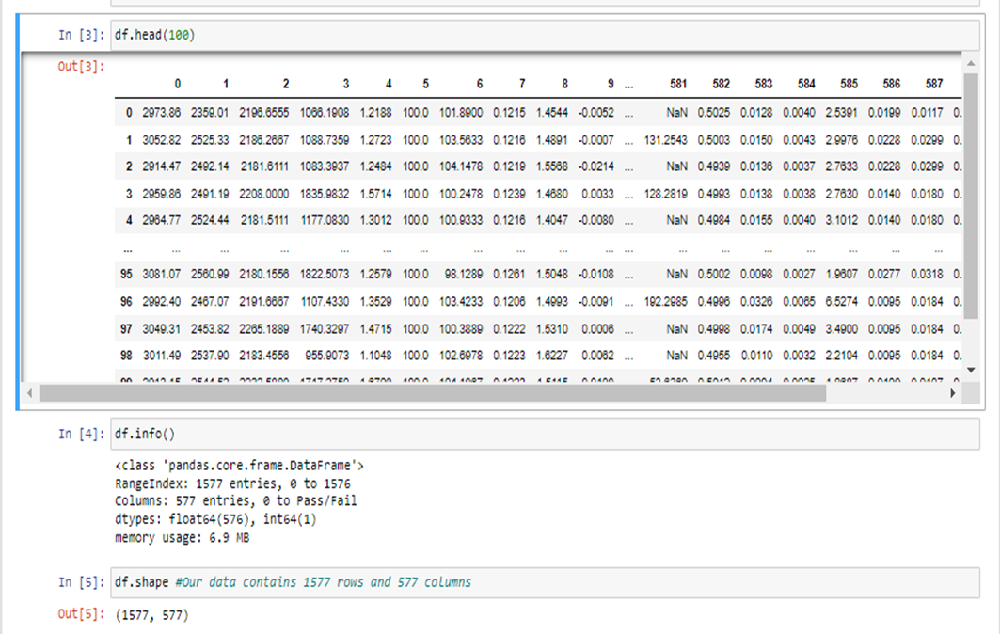 


objective:
•	To save the manufacturing time and cost, Reduce the number of testing points (currently it is more than 550, Target to reduce it at-least  140.) 
Important: - After reduction of Testing points 550 to 140, the assembly line will be redesign to save money without significant compromise in quality


#### Some important observations
* How PCA Works?
  - PCA don't drop the entire column from the dataset, it just drop the values.
    and merge all the columns and create a new dimension dataset only.
    Where we apply the algorithm.
* Original identity of the columns will not be available after applying 
  the PCA.
* So PCA is not a good option to work on this dataset.
* FOR EXAMOPLE:
    -lets say we have a dataset which is having 10 ( X1,X2...X10 )predictor variable columns
    and a target variable column. Target variable has 100 records. so PVs 
    should also be having 100 records each. 
    - Now lets assume that X1 is not important variable for prediction but we cannot
    leave the PV X1, than what PCA will do is it will not remove the entice column 
    it will just remove some insignificant values which are causing for X1 to make
    irrelevant. similarly from other columns too irrelevent values will be removed
    by PCA. Now after applying PCA let say total records remaining are 600. So TV
    is having 100 records according to this PV should be having 100 records each.
    So 600 records can be consisting only 6 PV( 100 records each). Dimension is 
    reduced.
    -But original identity of the column will be lost.

* Because the original dataset will be change after applying PCA. So we
 apply PCA on this dataset.
* So what are the other options are there without applying PCA?
  - Using VIF  
  - find correlation matrix and use heatmap 
  - Unique variable method
  - Recursive Feature elimination method
  - Anova testing hypothesis

#### Given dataset is highly imbalence. So what approach we will follow?
* What is the meaning of imbalence dataset?
  - when a perticular one class is having more no of observations or records
    and other class is having less no of records.
  - lets say 80/20 ratio in the records.
* How to balence the data?
 - data balancing approch
    - under sampling approach
    - oversampling approach
    - SMOTE technique
* in undersampling- lets say we have 900 no of records in majority class     and 100
  no is minority class. what it will do is, it will select randomly just     100 no
  of observations inout of 900 observations.
  - so finally what happened:
        * we have 100---class 0
        * 100----class 1
        
        -Now we have only 200 no of observations to train the model. But in 
         reality we have 1000 no of observations.
        - in under sampling we work on very few no of observations thats             will be depend on observations in minority class.
* In oversampling:
    - lets assume in majority class we have 900 samples and in minority we have 100 samples. what this method will do is, it will make the minority class samples equal to the majority class samples by duplicating the samples in minority class. It will duplicate the samples randomly. 
    - finally once we apply the oversampling we will be training our model by 1800 samples. but originally we have only 1000 samples. This is calledoversampling method.
* Smooth Technique:
    - Suppose you don't want to create duplicate samples.
    - So one good technique is the smooth technique. 
    - It works on the principle of k-nearest neighbours (KNN).
    - 900 for the majority class is okay. but for the 100 samples in minority class it will create a similar ( to 100 samples not duplicate) kind of observations and increase the samples to 900. Now total no of observations will be 1800 also.
    - But the difference between Oversampling method and Smooth technique is first one is making duplicates but later one is not making duplicates. it is just making similar kind of observations to the minority class by using KNN algorithm.
* This will be done by Imblearn package.

#### To balace the data, what kind of data we want to balance?
* Do we apply data balancing process on the whole dataset or do we apply it
 on the training dataset only?
 -Ans is we will apply it on training dataset bcoz if we apply it on the 
  whole dataset and then split the data into training and testing dataset 
  performence will be very good no doubt. But that performance will be
  biased. it will not the correct performance.

#
* If our data is imbalance-
 - Its clearly mentioned that balancing the data is not a very good
    solution. Because many industry will not allow you to balance the data.
- for example- 
 1. in madical domain- Under sampling is not suggest bcoz it reduces the 
    records. Oversampling duplicates the records bcoz of it redudndacy and
    overfitting problem also occur.
    SMOTE technique works on KNN technique, so if nearest neighbour is 
    having some desease then it will create the sample like the neighbour.
    but it is not necessary that perticular desease is having same cause.
    So SMOTE technique is also not suggested in medical domain. It can be 
    benificial in e-commarce oor any other domain.

#
1. First thing we must know what kind of different algorithms are with us.
2. Usually tree based algorithm like ensemble learning do well in
   imbalance dataset.
3. There are other sampling techniques are there-
   - stratified sampling( at the time of train_test_split we can apply it.
                        in the code only when we are splitting)
   - equal proportion of the catagories in population, same proporton of        the categories will be there in sample.
4. KNN stratify approcah
5. Excellent hyperparameter tuning
6. Weight balance approcach is there.
7. if nothing will work we can sample the training dataset.



In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')
import os
os.getcwd()

'C:\\Users\\ASUS\\Learnbay\\ML_Projects\\Manufacturing_Project'

In [2]:
# reading the dataset
df= pd.read_csv("Ultrasound_1.csv")
df.head(10)

,0,1,2,3,4,5,6,7,8,9,...,581,582,583,584,585,586,587,588,589,Pass/Fail
0,2973.86,2359.01,2196.6555,1066.1908,1.2188,100.0,101.8900,0.1215,1.4544,-0.0052,...,NaN,0.5025,0.0128,0.0040,2.5391,0.0199,0.0117,0.0043,58.5665,1
1,3052.82,2525.33,2186.2667,1088.7359,1.2723,100.0,103.5633,0.1216,1.4891,-0.0007,...,131.2543,0.5003,0.0150,0.0043,2.9976,0.0228,0.0299,0.0105,131.2543,-1
2,2914.47,2492.14,2181.6111,1083.3937,1.2484,100.0,104.1478,0.1219,1.5568,-0.0214,...,NaN,0.4939,0.0136,0.0037,2.7633,0.0228,0.0299,0.0105,131.2543,-1
3,2959.86,2491.19,2208.0000,1835.9832,1.5714,100.0,100.2478,0.1239,1.4680,0.0033,...,128.2819,0.4993,0.0138,0.0038,2.7630,0.0140,0.0180,0.0054,128.2819,1
4,2964.77,2524.44,2181.5111,1177.0830,1.3012,100.0,100.9333,0.1216,1.4047,-0.0080,...,NaN,0.4984,0.0155,0.0040,3.1012,0.0140,0.0180,0.0054,128.2819,1
5,3045.70,2456.17,2184.8778,960.8486,1.0160,100.0,102.5333,0.1215,1.5859,-0.0139,...,223.6518,0.5065,0.0188,0.0048,3.7138,0.0082,0.0184,0.0074,223.6518,-1
6,3057.03,2468.41,2184.8778,960.8486,1.0160,100.0,102.5333,0.1218,1.4549,-0.0125,...,62.1248,0.5067,0.0126,0.0034,2.4798,0.0195,0.0121,0.0048,62.1248,-1
7,2969.50,2546.75,2221.9444,1551.6947,1.5296,100.0,99.2678,0.1229,1.4519,-0.0206,...,185.5679,0.5028,0.0125,0.0029,2.4863,0.0075,0.0140,0.0045,185.5679,-1
8,2892.37,2517.09,2184.8778,960.8486,1.0160,100.0,102.5333,0.1219,1.4580,0.0063,...,47.0849,0.5067,0.0096,0.0028,1.8953,0.0215,0.0101,0.0029,47.0849,-1
9,3026.79,2474.32,2181.6111,1083.3937,1.2484,100.0,104.1478,0.1219,1.4059,-0.0083,...,64.8236,0.5028,0.0228,0.0050,4.5331,0.0337,0.0219,0.0074,64.8236,-1


In [3]:
df["Pass/Fail"].unique()

array([ 1, -1], dtype=int64)

#### AIM
1. More than 500 number of testing required which is a very time 
   consuming process as well as expensive process. So in the compititive 
   Market the menufacturar is interested to reduce the menufacturing time      As well as involvement of the menpower.
2. One of the goal is to reduce the time of testing of the device
  ---- Dimentionility Reduction while retaining most of the important
       information
2. How to get the same no of accuracy after droping some columns or 
   information.
3. Once drop the good amount of column At the end we have to inform the 
   stakeholder what are the different columns are still available. Means      the original identity of the column is required.
    

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1577 entries, 0 to 1576
Columns: 577 entries, 0 to Pass/Fail
dtypes: float64(576), int64(1)
memory usage: 6.9 MB


In [5]:
pd.set_option("display.max_columns",1000)
pd.set_option("display.max_rows", 1000)

In [6]:
df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,50,51,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,70,71,72,73,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,195,196,197,198,199,200,201,202,203,204,205,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,Pass/Fail
0,2973.86,2359.01,2196.6555,1066.1908,1.2188,100.0,101.8900,0.1215,1.4544,-0.0052,-0.0003,0.9554,198.2289,9.5221,403.3885,10.7177,0.9720,187.5112,12.4690,1.3993,-6362.50,3051.25,-3718.50,1500.25,0.9955,1.9012,5.2713,65.8000,3.1444,0.2229,4.7036,85.4579,8.6667,50.2987,64.2122,49.7013,66.0973,86.9255,117.9550,14.55,4.866,70.0,358.9764,10.1073,124.9991,721.5050,1.3362,147.7673,631.7427,214.7661,4.544,4.782,2910.0,0.9330,0.9502,4.7451,26.7745,357.1600,10.3983,111.7736,10.5591,13.2255,20.1161,701.3889,1.0994,152.2500,621.1836,72.1031,NaN,NaN,-0.0542,-0.0422,-0.0066,-0.0333,0.0577,0.0753,-0.0412,0.0171,7.0149,0.1418,NaN,2.4152,0.9907,1832.1146,0.2036,8549.8000,-0.0928,0.0023,-0.0004,-0.0001,0.0003,-0.0255,0.0233,-0.0223,0.0000,0.0000,0.0010,-0.0060,0.0003,-0.0022,0.0004,-0.1042,-0.0873,NaN,NaN,NaN,0.4550,0.9471,0.0,738.6785,0.9907,57.9642,0.5964,0.9749,6.7499,15.79,3.609,15.85,15.80,0.9176,2.761,0.6274,3.565,0.6623,0.6956,0.9965,2.3403,1012.1967,36.5767,136.0,123.9,151.3,64.0999,480.9570,0.1297,0.0,4.58,0.0043,0.0525,0.0800,0.0626,0.0203,4.0267,12.328,6.774,0.8158,0.0123,3.6348,0.45,0.0359,NaN,NaN,145.0,562.0,788.0,157.0,0.124,0.080,0.123,3.1,0.6,0.056,0.160,0.9365,0.1320,0.2885,0.4569,0.2885,0.8603,0.1965,0.219,0.0,0.0,14.82,0.404,7.08,16.977,0.1392,6.32,0.0,9.41,40.839,0.231,9.01,16.55,0.284,3.88,13.62,9.01,12.878,24.0891,0.4502,8.78,13.62,104.261,0.0,0.1249,0.0821,0.0713,0.0973,0.1060,0.0947,0.0529,0.0960,4.7209,0.0033,NaN,0.0353,0.0006,63.5398,0.0670,1460.8999,0.0,0.0308,0.0193,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0041,0.0042,0.0,0.0,0.0,0.0,NaN,NaN,NaN,0.1085,0.0203,0.0,147.5352,0.0012,2.9093,0.0273,0.0043,0.3552,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0699,8.140,2.3331,34.4617,48.7921,48.2584,22.5106,149.6750,0.0405,0.0,1.4215,0.0009,0.0184,0.0200,0.01

In [7]:
# Null values
df.isnull().sum()

0               5
1               7
2              14
3              14
4              14
5              14
6              14
7               9
8               2
9               2
10              2
11              2
12              2
14              3
15              3
16              3
17              3
18              3
19             10
20              0
21              2
22              2
23              2
24              2
25              2
26              2
27              2
28              2
29              2
30              2
31              2
32              1
33              1
34              1
35              1
36              1
37              1
38              1
39              1
40             24
41             24
42              1
43              1
44              1
45              1
46              1
47              1
48              1
50              1
51              1
53              4
54              4
55              4
56              4
57              4
58        

In [8]:
df.isnull().sum().sum()

42093

In [9]:
# handling missing values
data = df.replace(np.NaN, 0)

In [10]:
data.isnull().sum().sum()

0

In [11]:
data['Pass/Fail'].value_counts()

-1    1472
 1     105
Name: Pass/Fail, dtype: int64

In [15]:
data['Pass/Fail']=data['Pass/Fail'].map({-1:1,1:0})

In [19]:
data["Pass/Fail"].value_counts()

1    1472
0     105
Name: Pass/Fail, dtype: int64

In [20]:
# plot bar chart, pie plot etc

In [21]:
# its a highly imbalance data

In [22]:
data.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,50,51,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,70,71,72,73,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,195,196,197,198,199,200,201,202,203,204,205,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,Pass/Fail
0,2973.86,2359.01,2196.6555,1066.1908,1.2188,100.0,101.8900,0.1215,1.4544,-0.0052,-0.0003,0.9554,198.2289,9.5221,403.3885,10.7177,0.9720,187.5112,12.4690,1.3993,-6362.50,3051.25,-3718.50,1500.25,0.9955,1.9012,5.2713,65.8000,3.1444,0.2229,4.7036,85.4579,8.6667,50.2987,64.2122,49.7013,66.0973,86.9255,117.9550,14.55,4.866,70.0,358.9764,10.1073,124.9991,721.5050,1.3362,147.7673,631.7427,214.7661,4.544,4.782,2910.0,0.9330,0.9502,4.7451,26.7745,357.1600,10.3983,111.7736,10.5591,13.2255,20.1161,701.3889,1.0994,152.2500,621.1836,72.1031,0.0000,0.0000,-0.0542,-0.0422,-0.0066,-0.0333,0.0577,0.0753,-0.0412,0.0171,7.0149,0.1418,0.0,2.4152,0.9907,1832.1146,0.2036,8549.8000,-0.0928,0.0023,-0.0004,-0.0001,0.0003,-0.0255,0.0233,-0.0223,0.0000,0.0000,0.0010,-0.0060,0.0003,-0.0022,0.0004,-0.1042,-0.0873,0.0,0.0,0.0,0.4550,0.9471,0.0,738.6785,0.9907,57.9642,0.5964,0.9749,6.7499,15.79,3.609,15.85,15.80,0.9176,2.761,0.6274,3.565,0.6623,0.6956,0.9965,2.3403,1012.1967,36.5767,136.0,123.9,151.3,64.0999,480.9570,0.1297,0.0,4.58,0.0043,0.0525,0.0800,0.0626,0.0203,4.0267,12.328,6.774,0.8158,0.0123,3.6348,0.45,0.0359,0.0,0.0,145.0,562.0,788.0,157.0,0.124,0.080,0.123,3.1,0.6,0.056,0.160,0.9365,0.1320,0.2885,0.4569,0.2885,0.8603,0.1965,0.219,0.0,0.0,14.82,0.404,7.08,16.977,0.1392,6.32,0.0,9.41,40.839,0.231,9.01,16.55,0.284,3.88,13.62,9.01,12.878,24.0891,0.4502,8.78,13.62,104.261,0.0,0.1249,0.0821,0.0713,0.0973,0.1060,0.0947,0.0529,0.0960,4.7209,0.0033,0.0,0.0353,0.0006,63.5398,0.0670,1460.8999,0.0,0.0308,0.0193,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0041,0.0042,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.1085,0.0203,0.0,147.5352,0.0012,2.9093,0.0273,0.0043,0.3552,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0699,8.140,2.3331,34.4617,48.7921,48.2584,22.5106,149.6750,0.0405,0.0,1.4215,0.0009,0.0184,0.020

In [12]:
nunique = data.apply(pd.Series.nunique)
nunique

0            1489
1            1497
2             503
3             512
4             503
5               2
6             505
7              89
8            1200
9             566
10            391
11            377
12           1536
14           1544
15           1550
16           1467
17            282
18           1537
19            355
20            552
21           1288
22           1169
23           1471
24           1485
25            697
26            616
27           1139
28            863
29            189
30            840
31           1266
32            333
33            326
34            325
35            326
36            326
37            320
38            324
39            328
40            286
41            311
42              2
43           1512
44           1369
45           1510
46           1551
47           1333
48           1477
50           1510
51           1551
53            154
54            170
55            108
56            188
57            160
58        

#### 
* Here we can see that some of the features having only one value int it. 
  So we can see that these features is not having much information regarding
  Pass/Fail because they are fixed, their contribution is same for all the 
  records. So no significantly different contribution is there.

In [13]:
data.shape

(1577, 577)

In [14]:
# lets find the independent variable having one unique value
const_cols = nunique[nunique==1].index
const_cols.shape

(102,)

# Must calculate the accuracy keeping all columns(577)

### 1. First Algorithm: Decision Tree


In [23]:
# Split the data into train and test
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import BernoulliNB

In [24]:
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score
from sklearn.svm import SVC

In [25]:
# split feature and target
X = data.drop('Pass/Fail', axis=1) 
Y = data['Pass/Fail']

In [26]:
X.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,50,51,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,70,71,72,73,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,195,196,197,198,199,200,201,202,203,204,205,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589
0,2973.86,2359.01,2196.6555,1066.1908,1.2188,100.0,101.8900,0.1215,1.4544,-0.0052,-0.0003,0.9554,198.2289,9.5221,403.3885,10.7177,0.9720,187.5112,12.4690,1.3993,-6362.50,3051.25,-3718.50,1500.25,0.9955,1.9012,5.2713,65.8000,3.1444,0.2229,4.7036,85.4579,8.6667,50.2987,64.2122,49.7013,66.0973,86.9255,117.9550,14.55,4.866,70.0,358.9764,10.1073,124.9991,721.5050,1.3362,147.7673,631.7427,214.7661,4.544,4.782,2910.0,0.9330,0.9502,4.7451,26.7745,357.1600,10.3983,111.7736,10.5591,13.2255,20.1161,701.3889,1.0994,152.2500,621.1836,72.1031,0.0000,0.0000,-0.0542,-0.0422,-0.0066,-0.0333,0.0577,0.0753,-0.0412,0.0171,7.0149,0.1418,0.0,2.4152,0.9907,1832.1146,0.2036,8549.8000,-0.0928,0.0023,-0.0004,-0.0001,0.0003,-0.0255,0.0233,-0.0223,0.0000,0.0000,0.0010,-0.0060,0.0003,-0.0022,0.0004,-0.1042,-0.0873,0.0,0.0,0.0,0.4550,0.9471,0.0,738.6785,0.9907,57.9642,0.5964,0.9749,6.7499,15.79,3.609,15.85,15.80,0.9176,2.761,0.6274,3.565,0.6623,0.6956,0.9965,2.3403,1012.1967,36.5767,136.0,123.9,151.3,64.0999,480.9570,0.1297,0.0,4.58,0.0043,0.0525,0.0800,0.0626,0.0203,4.0267,12.328,6.774,0.8158,0.0123,3.6348,0.45,0.0359,0.0,0.0,145.0,562.0,788.0,157.0,0.124,0.080,0.123,3.1,0.6,0.056,0.160,0.9365,0.1320,0.2885,0.4569,0.2885,0.8603,0.1965,0.219,0.0,0.0,14.82,0.404,7.08,16.977,0.1392,6.32,0.0,9.41,40.839,0.231,9.01,16.55,0.284,3.88,13.62,9.01,12.878,24.0891,0.4502,8.78,13.62,104.261,0.0,0.1249,0.0821,0.0713,0.0973,0.1060,0.0947,0.0529,0.0960,4.7209,0.0033,0.0,0.0353,0.0006,63.5398,0.0670,1460.8999,0.0,0.0308,0.0193,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0041,0.0042,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.1085,0.0203,0.0,147.5352,0.0012,2.9093,0.0273,0.0043,0.3552,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0699,8.140,2.3331,34.4617,48.7921,48.2584,22.5106,149.6750,0.0405,0.0,1.4215,0.0009,0.0184,0.0200,0.0185,0

In [27]:
Y.head()

0    0
1    1
2    1
3    0
4    0
Name: Pass/Fail, dtype: int64

In [30]:
# split the data into train and test data
x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.3,
                                                   stratify=Y, 
                                                   random_state=101)

In [34]:
x_train.value_counts().sum()

1103

In [35]:
y_train.value_counts().sum()

1103

In [36]:
x_test.value_counts().sum()

474

In [37]:
y_test.value_counts().sum()

474

In [44]:
y_train.value_counts(nunique[0]==0)

1    1030
0      73
Name: Pass/Fail, dtype: int64

In [45]:
1030/73

14.10958904109589

In [46]:
442/32

13.8125

In [42]:
y_test.value_counts(nunique[0]==0)

1    442
0     32
Name: Pass/Fail, dtype: int64

In [47]:
models = {
    'Logistic Regression': LogisticRegression(max_iter=200),
    'Decision Tree Classifier': DecisionTreeClassifier(),
    'Random Forest Classifier': RandomForestClassifier(),
    'K_Nearest Neighbors': KNeighborsClassifier(),
    'Naive Bays Classifier': BernoulliNB(),
    'SVM Classifier': SVC()
    
}

In [50]:
# Train models and evaluate
results= {}
for name, model in models.items():
    model.fit(x_train, y_train)
    y_pred = model.predict(x_test)
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average= 'weighted')
    results[name]= {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall}
    

# print and compare result
result_df = pd.DataFrame(results).T
print(result_df)

                          Accuracy  Precision    Recall
Logistic Regression       0.924051   0.894462  0.924051
Decision Tree Classifier  0.862869   0.878776  0.862869
Random Forest Classifier  0.930380   0.893619  0.930380
K_Nearest Neighbors       0.930380   0.869403  0.930380
Naive Bays Classifier     0.894515   0.880835  0.894515
SVM Classifier            0.932489   0.869537  0.932489


### above accuracy we have to maintain whille reducing the no of columns from the dataset.

In [52]:
# drop these columns which has only one unique values
data1 = data.drop(const_cols, axis=1)

In [54]:
# after dropping the cplumns which have only one value in it
data1.shape

(1577, 475)

### Again we will check the accuracy of the new dataset after dropping the columns

In [55]:
X1= data1.drop('Pass/Fail', axis=1)
Y1 = data1['Pass/Fail']

In [80]:
x1_train, x1_test, y1_train,y1_test= train_test_split(X1,Y1, test_size=0.3,
                                                     stratify=Y1,
                                                     random_state=101)

In [81]:
models = {
    'Logistic Regression': LogisticRegression(max_iter=200),
    'Decision Tree Classifier': DecisionTreeClassifier(),
    'Random Forest Classifier': RandomForestClassifier(),
    'K_Nearest Neighbors': KNeighborsClassifier(),
    'Naive Bays Classifier': BernoulliNB(),
    'SVM Classifier': SVC()
    
}

In [82]:
# Train models and evaluate
results_1= {}
for name, model in models.items():
    model.fit(x1_train, y1_train)
    y1_pred = model.predict(x1_test)
    accuracy = accuracy_score(y1_test, y1_pred)
    precision = precision_score(y1_test, y1_pred, average='weighted')
    recall = recall_score(y1_test, y1_pred, average= 'weighted')
    results_1[name]= {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall}
    

# print and compare result
result_df_1 = pd.DataFrame(results_1).T
print(result_df_1)

                          Accuracy  Precision    Recall
Logistic Regression       0.928270   0.899775  0.928270
Decision Tree Classifier  0.879747   0.893977  0.879747
Random Forest Classifier  0.930380   0.893619  0.930380
K_Nearest Neighbors       0.930380   0.869403  0.930380
Naive Bays Classifier     0.879747   0.887957  0.879747
SVM Classifier            0.932489   0.869537  0.932489


### There is not much difference in the accuracies of data and data1 dataframes

### for dimentionality reduction, multicolinerity approcah
1. Pearson formula (bydefault)

In [59]:
# create corr matrix
corr_matrix = data1.corr()
corr_matrix

,0,1,2,3,4,5,6,7,8,9,10,11,12,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,50,51,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,70,71,72,73,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,142,143,144,145,146,147,148,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,180,181,182,183,184,185,187,188,195,196,197,198,199,200,201,202,203,204,205,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,227,228,238,239,244,245,246,247,248,249,250,251,252,253,254,255,267,268,269,270,271,272,273,274,275,277,278,279,280,281,282,283,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,316,317,318,319,320,321,323,324,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,365,366,367,368,376,377,382,383,384,385,386,387,388,389,390,391,392,393,405,406,407,408,409,410,411,412,413,415,416,417,418,419,420,421,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,452,453,454,455,456,457,459,460,467,468,469,470,471,472,473,474,475,476,477,478,479,480,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,499,500,510,511,516,517,518,519,520,521,522,523,524,525,526,527,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,Pass/Fail
0,1.000000,-0.051731,0.009742,0.005773,-0.001583,0.011104,0.008468,0.011955,-0.056840,0.012133,-0.017591,-0.002184,0.001246,-0.042683,0.007928,-0.002633,0.002357,0.008941,0.012924,-0.004946,-0.014800,0.019205,-0.006614,-0.016659,0.012698,0.017099,0.013448,0.055876,0.006871,-0.007209,0.004475,0.001386,-0.008008,0.004331,0.006125,-0.002699,-0.004291,-0.012262,0.002410,0.031904,0.016981,-0.014059,-0.026355,0.010844,0.023776,-0.000329,-0.040269,-0.015077,-0.009387,-0.030766,0.004603,0.005845,-0.013203,-0.003142,-0.003117,-0.008898,-0.079654,-0.013656,-0.004795,0.004141,-0.019296,0.011312,0.001412,-0.007186,-0.006595,-0.004122,-0.007787,0.013704,0.008840,0.009031,0.037457,0.019917,0.003905,0.030712,-0.070895,0.023521,0.053514,0.028016,0.005198,-0.007808,-0.001605,-0.001391,0.030751,-0.017955,-0.007265,0.003471,-0.007505,-0.021662,0.030375,-0.015613,0.000204,0.018904,-0.031432,-0.028352,0.024497,-0.022538,0.011438,-0.060543,0.028058,0.021414,-0.031808,0.008590,-0.038086,0.053424,0.054094,0.053284,-0.078640,-0.035798,0.001833,0.012597,0.062784,0.004702,-0.025102,-0.014430,0.024195,0.006334,-0.023016,0.005470,0.005472,0.018009,-0.042246,-0.025380,-0.019168,-0.052478,0.012475,0.005899,-0.002090,0.001545,0.004485,-0.022475,0.190199,0.087538,-0.003419,0.015487,-0.001784,0.000723,-0.020041,0.015308,0.028316,0.001757,-0.004623,0.006660,-0.000966,0.001208,0.002791,-0.012089,0.015784,-0.002656,0.014133,-0.023915,-0.079873,-0.013862,0.009760,0.024977,0.006287,0.001675,-0.002826,-0.007612,0.036627,0.022175,0.028284,0.021039,-0.027062,0.014663,0.005390,0.006308,0.005358,-0.003361,0.024674,-0.039653,0.036007,-0.003772,0.030710,0.028028,0.008371,0.011538,0.012059,-0.067276,0.014658,-0.005324,0.006458,0.000032,0.001260,0.004334,0.003904,-0.002440,-0.001692,-0.008053,-0.017346,0.002572,-0.013653,-0.010385,0.033577,-0.005058,-0.018993,-0.018033,0.028098,-0.028999,0.053522,-0.004772,-0.016154,-0.074077,-0.014284,0.037270,-0.017858,0.015090,-0.028246,-0.049043,-0.027113,-0.080058,0.009582,0.003661,0.025546,0.037249,0.037227,-0.024357,-0.008991,0.000173,-0.026115,0.003387,0.000110,0.001627,0.012987,-0.033933,0.065779,-0.036919,0.002731,-0.027571,0.189888,0.090551,-0.004800,0.016984,-0

## best banchmark -
 - below -0.9 --highly correlated in negative direction
    or above 0.9--highly correlated in positive direction

#####
* here columns are huge so heatmap is not the best way to visualize the 
  correlation between columns.

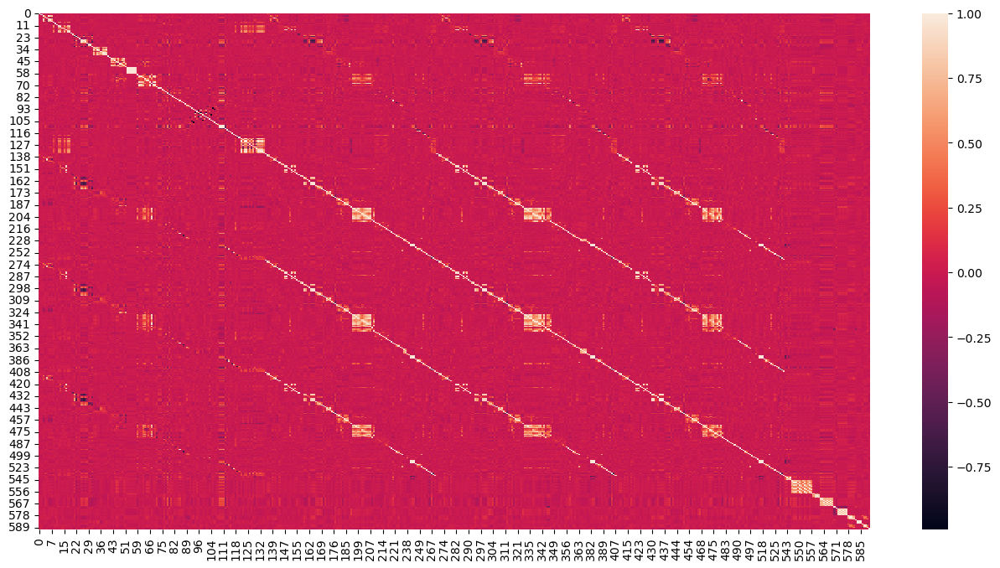

In [60]:
# plot a heat map
plt.figure(figsize=(16,8))
sns.heatmap(corr_matrix)
plt.show()

### 
* we can see it is not visible clearly in heatmap
* split the corr matrix into two parts upper tringle and lower tringle

In [66]:
# select the upper triangle of corr matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
upper

,0,1,2,3,4,5,6,7,8,9,10,11,12,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,50,51,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,70,71,72,73,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,142,143,144,145,146,147,148,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,180,181,182,183,184,185,187,188,195,196,197,198,199,200,201,202,203,204,205,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,227,228,238,239,244,245,246,247,248,249,250,251,252,253,254,255,267,268,269,270,271,272,273,274,275,277,278,279,280,281,282,283,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,316,317,318,319,320,321,323,324,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,365,366,367,368,376,377,382,383,384,385,386,387,388,389,390,391,392,393,405,406,407,408,409,410,411,412,413,415,416,417,418,419,420,421,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,452,453,454,455,456,457,459,460,467,468,469,470,471,472,473,474,475,476,477,478,479,480,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,499,500,510,511,516,517,518,519,520,521,522,523,524,525,526,527,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,Pass/Fail
0,NaN,-0.051731,0.009742,0.005773,-0.001583,0.011104,0.008468,0.011955,-0.056840,0.012133,-0.017591,-0.002184,0.001246,-0.042683,0.007928,-0.002633,0.002357,0.008941,0.012924,-0.004946,-0.014800,0.019205,-0.006614,-0.016659,0.012698,0.017099,0.013448,0.055876,0.006871,-0.007209,0.004475,0.001386,-0.008008,0.004331,0.006125,-0.002699,-0.004291,-0.012262,0.002410,0.031904,0.016981,-0.014059,-0.026355,0.010844,0.023776,-0.000329,-0.040269,-0.015077,-0.009387,-0.030766,0.004603,0.005845,-0.013203,-0.003142,-0.003117,-0.008898,-0.079654,-0.013656,-0.004795,0.004141,-0.019296,0.011312,0.001412,-0.007186,-0.006595,-0.004122,-0.007787,0.013704,0.008840,0.009031,0.037457,0.019917,0.003905,0.030712,-0.070895,0.023521,0.053514,0.028016,0.005198,-0.007808,-0.001605,-0.001391,0.030751,-0.017955,-0.007265,0.003471,-0.007505,-0.021662,0.030375,-0.015613,0.000204,0.018904,-0.031432,-0.028352,0.024497,-0.022538,0.011438,-0.060543,0.028058,0.021414,-0.031808,0.008590,-0.038086,0.053424,0.054094,0.053284,-0.078640,-0.035798,0.001833,0.012597,0.062784,0.004702,-0.025102,-0.014430,0.024195,0.006334,-0.023016,0.005470,0.005472,0.018009,-0.042246,-0.025380,-0.019168,-0.052478,0.012475,0.005899,-0.002090,0.001545,0.004485,-0.022475,0.190199,0.087538,-0.003419,0.015487,-0.001784,0.000723,-0.020041,0.015308,0.028316,0.001757,-0.004623,0.006660,-0.000966,0.001208,0.002791,-0.012089,0.015784,-0.002656,0.014133,-0.023915,-0.079873,-0.013862,0.009760,0.024977,0.006287,0.001675,-0.002826,-0.007612,0.036627,0.022175,0.028284,0.021039,-0.027062,0.014663,0.005390,0.006308,0.005358,-0.003361,0.024674,-0.039653,0.036007,-0.003772,0.030710,0.028028,0.008371,0.011538,0.012059,-0.067276,0.014658,-0.005324,0.006458,0.000032,0.001260,0.004334,0.003904,-0.002440,-0.001692,-0.008053,-0.017346,0.002572,-0.013653,-0.010385,0.033577,-0.005058,-0.018993,-0.018033,0.028098,-0.028999,0.053522,-0.004772,-0.016154,-0.074077,-0.014284,0.037270,-0.017858,0.015090,-0.028246,-0.049043,-0.027113,-0.080058,0.009582,0.003661,0.025546,0.037249,0.037227,-0.024357,-0.008991,0.000173,-0.026115,0.003387,0.000110,0.001627,0.012987,-0.033933,0.065779,-0.036919,0.002731,-0.027571,0.189888,0.090551,-0.004800,0.016984,-0.0017

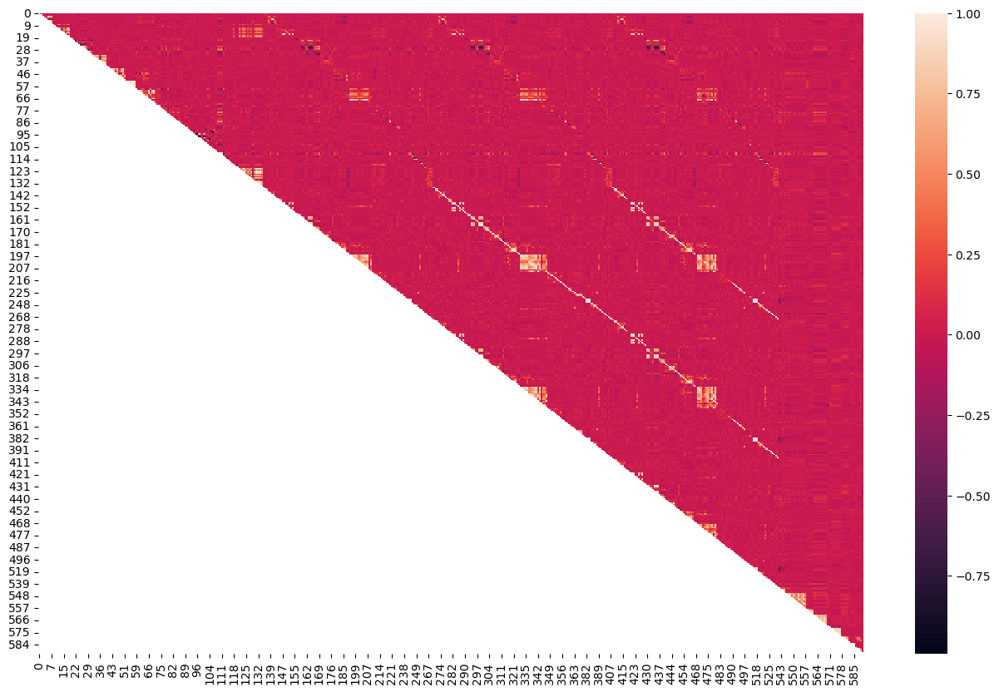

In [67]:
# Plot heat map
plt.figure(figsize=(16,10))
sns.heatmap(upper)
plt.show()

In [68]:
# finding the columns having high correlation coefficient, more than 0.9 and less than -0.9
neg_correlated = [ column for column in upper.columns
                  if any (upper[column]<=-0.9)]
pos_correlated = [ column for column in upper.columns
                  if any (upper[column]>=0.9)]

print(neg_correlated)

print("*************"*5)

print(pos_correlated)

['96', '104', '105', '106']
*****************************************************************
['5', '18', '27', '38', '39', '50', '54', '55', '56', '57', '58', '66', '70', '73', '101', '110', '111', '123', '124', '127', '131', '133', '140', '148', '152', '154', '164', '165', '174', '199', '204', '207', '220', '245', '246', '249', '252', '270', '271', '272', '273', '274', '275', '277', '278', '279', '280', '281', '282', '283', '285', '286', '287', '288', '289', '290', '291', '292', '293', '294', '295', '296', '297', '298', '299', '300', '301', '302', '303', '304', '305', '306', '307', '308', '309', '310', '311', '312', '317', '318', '319', '320', '321', '323', '324', '331', '332', '333', '334', '335', '336', '337', '338', '339', '340', '341', '342', '343', '344', '346', '347', '348', '349', '350', '351', '352', '353', '354', '355', '356', '357', '358', '359', '360', '361', '362', '363', '365', '366', '376', '377', '382', '383', '384', '385', '386', '387', '388', '389', '390', '391', '39

#### we will drop the columns which are having high multicolinerity.

In [69]:
total_correlated = neg_correlated + pos_correlated
print(len(total_correlated))

226


In [70]:
data2 = data1.drop(total_correlated, axis=1)
data2.shape

(1577, 249)

#### 
* Now we will be havinf only 249 columns
* Again we will check the accuracy of the dataset= data2

In [87]:
X2= data2.drop("Pass/Fail", axis=1)
Y2 = data2["Pass/Fail"]
x2_train, x2_test, y2_train, y2_test = train_test_split(X2, Y2, test_size=0.3,
                                                       stratify=Y2,
                                                       random_state=101)

In [88]:
models = {
    'Logistic Regression': LogisticRegression(max_iter=200),
    'Decision Tree Classifier': DecisionTreeClassifier(),
    'Random Forest Classifier': RandomForestClassifier(),
    'K_Nearest Neighbors': KNeighborsClassifier(),
    'Naive Bays Classifier': BernoulliNB(),
    'SVM Classifier': SVC()
    
}


In [89]:
# Train models and evaluate
results_2= {}
for name, model in models.items():
    model.fit(x2_train, y2_train)
    y2_pred = model.predict(x2_test)
    accuracy = accuracy_score(y2_test, y2_pred)
    precision = precision_score(y2_test, y2_pred, average='weighted')
    recall = recall_score(y2_test, y2_pred, average= 'weighted')
    results_2[name]= {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall}
    

# print and compare result
result_df_2 = pd.DataFrame(results_2).T
print(result_df_2)

                          Accuracy  Precision    Recall
Logistic Regression       0.928270   0.895218  0.928270
Decision Tree Classifier  0.879747   0.893977  0.879747
Random Forest Classifier  0.932489   0.905001  0.932489
K_Nearest Neighbors       0.928270   0.869270  0.928270
Naive Bays Classifier     0.902954   0.873593  0.902954
SVM Classifier            0.932489   0.869537  0.932489


### Here we can see that we have retailed the accuracy till now after dropping around 350 columns

In [90]:
data2.shape

(1577, 249)

###
* lets Scale the dataset

In [93]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaled_feature = scaler.fit_transform(data2)
scaled_feature = pd.DataFrame(scaled_feature, columns= data2.columns)

In [94]:
scaled_feature

,0,1,2,3,4,6,7,8,9,10,11,12,14,15,16,17,19,20,21,22,23,24,25,26,28,29,30,31,32,33,34,35,36,37,40,41,42,43,44,45,46,47,48,51,53,59,60,61,62,63,64,65,67,68,71,72,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,98,99,100,102,103,107,108,109,112,113,114,115,116,117,118,119,120,121,122,125,126,128,129,130,132,134,135,136,137,138,139,142,143,144,145,146,147,150,151,153,155,156,157,158,159,160,161,162,163,166,167,168,169,170,171,172,173,175,176,177,180,181,182,183,184,185,187,188,195,196,197,198,200,201,202,203,205,208,209,210,211,212,213,214,215,216,217,218,219,221,222,223,224,225,227,228,238,239,244,247,248,250,251,253,254,255,267,268,269,316,345,367,368,412,418,419,423,430,431,432,433,438,439,460,468,472,473,474,476,480,482,483,484,485,486,487,488,489,496,499,500,510,511,521,542,543,544,546,547,549,550,551,555,558,559,560,562,564,565,570,571,572,573,578,579,581,582,583,586,587,589,Pass/Fail
0,0.886040,0.828758,0.948770,0.286993,0.001094,0.788304,0.906716,0.878049,0.375682,0.393629,0.970146,0.728662,0.487151,0.488999,0.104189,0.987002,0.959907,0.802338,0.110171,0.834530,0.507561,0.563973,0.719916,0.926150,0.844673,0.895560,0.781831,0.979019,0.809231,0.371240,0.841522,0.681195,0.990753,0.972611,0.168950,0.130201,1.0,0.951442,0.914440,0.739457,0.919969,0.884257,0.905155,0.830678,0.953820,0.282867,0.955315,0.882341,0.389250,0.056138,0.269973,0.170355,0.000151,0.907163,0.302348,0.253214,0.150713,0.557060,0.412284,0.527118,0.724225,0.834922,0.363985,0.644980,0.780266,0.942193,0.0,0.551757,0.987191,0.428383,0.138249,0.795582,0.367097,0.366093,0.549342,0.612903,0.666667,0.675253,0.357926,0.566038,0.643663,0.505639,0.414997,0.349161,0.0,0.931423,0.762408,0.0,0.511563,0.983398,0.019918,0.955004,0.944915,0.677768,0.982576,0.523879,0.372252,0.691807,0.915276,0.712089,0.782981,0.946608,0.570364,0.136821,0.418864,0.452047,0.452045,0.271621,0.044298,0.355372,0.083960,0.319107,0.252521,0.020750,0.552379,0.012625,0.051486,0.035405,0.011322,0.0,0.0,0.018611,0.134772,0.020768,0.004258,0.129572,0.146919,0.036810,0.077241,0.139983,0.812229,0.267206,0.526076,0.528636,0.734044,0.445477,0.117869,0.304500,0.113070,0.128727,0.232731,0.043119,0.023590,0.030559,0.212892,0.047747,0.022746,0.065449,0.028352,0.068230,0.071208,0.026252,0.048145,0.027433,0.604941,0.0,0.241867,0.254416,0.120013,0.075797,0.139199,0.276174,0.187058,0.142349,0.536374,0.202454,0.072684,0.000303,0.018010,0.046654,0.405659,0.199870,0.090483,0.168033,0.177966,0.0,0.220798,0.017831,0.115159,0.000909,0.060438,0.033766,0.285875,0.442966,0.208040,0.229796,0.337666,0.000000,0.100840,0.215569,0.351647,0.000000,0.000000,0.305193,0.005698,0.046047,0.021313,0.010510,0.022406,0.038197,0.127292,0.033656,0.261761,0.189793,0.154100,0.148976,0.651425,0.230419,0.196503,0.000000,0.294177,0.183862,0.126301,0.128639,0.563144,0.149733,0.000000,0.000000,0.152304,0.000000,0.0,0.925676,0.325,0.553191,0.153572,0.951098,0.041822,0.240794,0.060071,0.159359,0.665829,0.308373,0.200808,0.851935,0.160221,0.078787,0.800072,0.746490,0.007249,0.024460,0.141186,0.000000,0.000000,0.985681,0.027153,0.307435,0.110821,0.079433,0.0
1,0.909565,0.887189,0.944283,0.293062,0.001142,0.801250,0.907463,0.898998,0.410756,0.296928,0.974817,0.745181,0.125199,0.499957,0.104666,0.989033,0.963048,0.735842,0.120276,0.829470,0.487034,0.563878,0.713408,0.922740,0.901725,0.749993,0.682918,0.970215,0.803172,0.369706,0.840727,0.681218,0.991699,0.970734,0.909313,0.065442,1.0,0.955540,0.883425,0.880858,0.963675,0.716961,0.823869,0.815019,0.963266,0.130558,0.966750,0.840864,0.437578,0.059087,0.474622,0.276366,0.000166,0.876331,0.292478,0.973840,0.222949,0.646035,0.480438,0.528959,0.375079,0.669844,0.413155,0.678912,0.800854,0.916944,0.0,0.586901,0.971638,0.489780,0.136688,0.851453,0.431569,0.299754,0.615132,0.645161,0.611111,0.693069,0.432907,0.566038,0.651824,0.537594,0.437116,0.247971,0.0,0.000000,0.742880,0.0,0.653663,0.983398,0.023666,0.946357,0.910311,0.451734,0.982576,0.543185,0.414199,0.687798,0.808472,0.621068,0.876857,0.95

# Now find the VIF to further redruce the columns which are havind coliniarity

#
* we must add the constant when we calculate VIF because in OLS it is mandatory to add constant when to calculate VIF but in sklearn.linear regression it is automatically added. And the impact of that conatant is nothing if we use other algorithm because the slope of the constant is zero.

In [103]:
import statsmodels.api as sm
df_1 = sm.add_constant(data2)
    

In [104]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif_1 = pd.DataFrame()
vif_1["variables"] = df_1.columns
vif_1["VIF"] = [ variance_inflation_factor(df_1.values,i)
             for i in range(df_1.shape[1])]
vif_1

,variables,VIF
0,const,123460.722908
1,0,1.273804
2,1,1.217282
3,2,12.647160
4,3,8.295323
5,4,3.945762
6,6,9.124807
7,7,6.928859
8,8,2.160770
9,9,1.404297


In [108]:
high_vif_1 = vif_1[vif_1['VIF']>10].sort_values("VIF")


In [109]:
high_vif_1["VIF"].value_counts().sum()

60

#### 
* Here we can see 60 columns are there having VIF >10, so we will drop them.
* Than we will calculate the accuracy after dropping the columns and copare 
  it by accuracy before dropping the column.

In [110]:
print(result_df_2)

                          Accuracy  Precision    Recall
Logistic Regression       0.928270   0.895218  0.928270
Decision Tree Classifier  0.879747   0.893977  0.879747
Random Forest Classifier  0.932489   0.905001  0.932489
K_Nearest Neighbors       0.928270   0.869270  0.928270
Naive Bays Classifier     0.902954   0.873593  0.902954
SVM Classifier            0.932489   0.869537  0.932489


In [112]:
# drop 60 columns which are having VIF >10
data3 = df_1.drop(high_vif_1["variables"], axis=1)

In [113]:
data3.shape

(1577, 190)

In [115]:
# To check the accuracy split the data 
X3 = data3.drop("Pass/Fail", axis=1)
Y3 = data3["Pass/Fail"]

In [116]:
x3_train, x3_test, y3_train, y3_test = train_test_split(X3, Y3,
                                                       test_size=0.3,
                                                       stratify=Y3,
                                                       random_state=101)

In [117]:
# Train models and evaluate
results_3= {}
for name, model in models.items():
    model.fit(x3_train, y3_train)
    y3_pred = model.predict(x3_test)
    accuracy = accuracy_score(y3_test, y3_pred)
    precision = precision_score(y3_test, y3_pred, average='weighted')
    recall = recall_score(y3_test, y3_pred, average= 'weighted')
    results_3[name]= {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall}
    

# print and compare result
result_df_3 = pd.DataFrame(results_3).T
print(result_df_3)

                          Accuracy  Precision    Recall
Logistic Regression       0.930380   0.893619  0.930380
Decision Tree Classifier  0.888186   0.892889  0.888186
Random Forest Classifier  0.932489   0.905001  0.932489
K_Nearest Neighbors       0.924051   0.869001  0.924051
Naive Bays Classifier     0.896624   0.881335  0.896624
SVM Classifier            0.932489   0.869537  0.932489


In [121]:
data3.shape

(1577, 190)

# Recursive Feature Elimination

In [120]:
from sklearn.feature_selection import SelectFromModel, RFECV
# RFECV- Recurcive feature elimination cross validation

In [123]:
X4 = data3.drop(["Pass/Fail"], axis=1)
Y4 = data3["Pass/Fail"]

In [124]:
x4_train, x4_test, y4_train, y4_test = train_test_split( X4, Y4, test_size=0.3,
                                                       stratify=Y4,
                                                       random_state=101)

In [125]:
x4_train.shape, x4_test.shape

((1103, 189), (474, 189))

In [ ]:
sfm = SelectFromModel(RandomForestClassifier(n_estimators=100, random_state=True,
                                            n_jobs=-1))

In [126]:
# Train models and evaluate
results_4= {}
for name, model in models.items():
    model.fit(x4_train, y4_train)
    y4_pred = model.predict(x4_test)
    accuracy = accuracy_score(y4_test, y4_pred)
    precision = precision_score(y4_test, y4_pred, average='weighted')
    recall = recall_score(y4_test, y4_pred, average= 'weighted')
    results_4[name]= {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall}
    

# print and compare result
result_df_4 = pd.DataFrame(results_4).T
print(result_df_4)

                          Accuracy  Precision    Recall
Logistic Regression       0.930380   0.893619  0.930380
Decision Tree Classifier  0.867089   0.882576  0.867089
Random Forest Classifier  0.932489   0.905001  0.932489
K_Nearest Neighbors       0.924051   0.869001  0.924051
Naive Bays Classifier     0.896624   0.881335  0.896624
SVM Classifier            0.932489   0.869537  0.932489


In [127]:
sfm = SelectFromModel(RandomForestClassifier(n_estimators=100, random_state=True,
                                            n_jobs=-1))

In [129]:
sfm.fit(x4_train, y4_train)

SelectFromModel(estimator=RandomForestClassifier(n_jobs=-1, random_state=True))

In [130]:
sfm.get_support()
# it will give that which of the column is important.
# it will give True for important column and give false for column which are not important

array([ True, False, False, False, False, False, False, False,  True,
        True,  True, False, False, False, False,  True,  True, False,
        True, False,  True, False,  True, False,  True, False,  True,
       False,  True,  True, False,  True,  True,  True,  True,  True,
        True, False,  True, False, False, False,  True, False,  True,
       False, False, False,  True, False,  True, False,  True,  True,
        True, False, False,  True, False, False,  True, False,  True,
        True,  True,  True, False, False, False, False,  True,  True,
       False,  True, False, False,  True, False, False, False, False,
        True, False,  True, False,  True, False, False,  True, False,
       False,  True, False,  True,  True, False,  True, False, False,
       False, False, False, False, False, False, False,  True, False,
       False, False, False,  True, False,  True, False, False,  True,
       False, False, False,  True,  True,  True,  True,  True, False,
       False, False,

In [133]:
print(" Banchmark: mean of feature importance:", np.mean(sfm.estimator_.feature_importances_))

 Banchmark: mean of feature importance: 0.005291005291005291


In [134]:
print("Banchmark: mean of feature importance:", np.median(sfm.estimator_.feature_importances_))

Banchmark: mean of feature importance: 0.0046727607960037


## whereever the value is grater than Banchmark it is considering true and wherever is less it is considering false

In [136]:
sfm.estimator_.feature_importances_

array([1.14489134e-02, 4.68388639e-03, 2.25979249e-03, 4.90788122e-03,
       2.67842349e-03, 3.20808501e-03, 2.52316312e-03, 2.46706628e-03,
       6.41271537e-03, 5.69284408e-03, 8.36674718e-03, 2.79936051e-03,
       4.23325378e-03, 4.57430750e-03, 4.03341673e-03, 1.45513020e-02,
       7.46802807e-03, 4.63438660e-03, 1.08773362e-02, 4.55370702e-03,
       1.07682824e-02, 2.45856089e-03, 5.42487692e-03, 4.52018950e-03,
       1.46098678e-02, 3.81759166e-03, 5.82634399e-03, 2.86160014e-03,
       1.79667089e-02, 7.58730441e-03, 4.40918047e-03, 5.93438214e-03,
       7.07993874e-03, 1.83235363e-02, 8.49530467e-03, 5.60539114e-03,
       5.51829445e-03, 5.06071286e-03, 7.56238357e-03, 5.06360581e-03,
       2.06853540e-03, 3.09026413e-06, 5.31975249e-03, 4.25791151e-03,
       6.26818168e-03, 4.07805002e-03, 4.86257670e-03, 4.62613005e-03,
       7.50385558e-03, 1.80034251e-03, 9.74049438e-03, 4.16680931e-03,
       1.00247200e-02, 1.37785922e-02, 9.04069270e-03, 5.21134813e-03,
      

In [137]:
feature_selected = x4_train.columns[sfm.get_support()]
feature_selected

Index(['0', '10', '11', '12', '21', '23', '28', '30', '33', '40', '47', '59',
       '71', '75', '76', '77', '78', '79', '80', '82', '86', '88', '93', '99',
       '102', '103', '107', '112', '115', '117', '118', '119', '120', '129',
       '130', '135', '138', '146', '153', '156', '161', '166', '168', '169',
       '171', '184', '210', '212', '215', '219', '221', '222', '223', '225',
       '247', '250', '267', '268', '269', '316', '438', '472', '476', '487',
       '500', '510', '550', '551', '558', '571', '573', '582', '583', '587'],
      dtype='object')

In [148]:
final = pd.DataFrame(feature_selected)

In [153]:
feature_selected

Index(['0', '10', '11', '12', '21', '23', '28', '30', '33', '40', '47', '59',
       '71', '75', '76', '77', '78', '79', '80', '82', '86', '88', '93', '99',
       '102', '103', '107', '112', '115', '117', '118', '119', '120', '129',
       '130', '135', '138', '146', '153', '156', '161', '166', '168', '169',
       '171', '184', '210', '212', '215', '219', '221', '222', '223', '225',
       '247', '250', '267', '268', '269', '316', '438', '472', '476', '487',
       '500', '510', '550', '551', '558', '571', '573', '582', '583', '587'],
      dtype='object')

In [167]:
final_data = data3[['0', '10', '11', '12', '21', '23', '28', '30', '33', '40', '47', '59',
       '71', '75', '76', '77', '78', '79', '80', '82', '86', '88', '93', '99',
       '102', '103', '107', '112', '115', '117', '118', '119', '120', '129',
       '130', '135', '138', '146', '153', '156', '161', '166', '168', '169',
       '171', '184', '210', '212', '215', '219', '221', '222', '223', '225',
       '247', '250', '267', '268', '269', '316', '438', '472', '476', '487',
       '500', '510', '550', '551', '558', '571', '573', '582', '583', '587', 'Pass/Fail']]

In [168]:
final_data.shape

(1577, 75)

## Finally we will check the Accuracy of the model with final reduced data

In [169]:
# split the data
X5 = final_data.drop(["Pass/Fail"], axis=1)
Y5 = final_data["Pass/Fail"]

In [170]:
x5_train, x5_test, y5_train, y5_test = train_test_split( X5, Y5, 
                                                       test_size=0.3,
                                                       stratify=Y5,
                                                       random_state=101)

In [171]:
# Train models and evaluate
results_final= {}
for name, model in models.items():
    model.fit(x5_train, y5_train)
    y5_pred = model.predict(x5_test)
    accuracy = accuracy_score(y5_test, y5_pred)
    precision = precision_score(y5_test, y5_pred, average='weighted')
    recall = recall_score(y5_test, y5_pred, average= 'weighted')
    results_final[name]= {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall}
    

# print and compare result
result_df_final = pd.DataFrame(results_final).T
print(result_df_final)

                          Accuracy  Precision    Recall
Logistic Regression       0.928270   0.869270  0.928270
Decision Tree Classifier  0.888186   0.889787  0.888186
Random Forest Classifier  0.932489   0.905001  0.932489
K_Nearest Neighbors       0.924051   0.881974  0.924051
Naive Bays Classifier     0.921941   0.868865  0.921941
SVM Classifier            0.932489   0.869537  0.932489


### Conclusion: Here we can see that we have retained the accuracy while reducing the columns from 587 to 75.

In [172]:
# Apply LDA- linear discriminant Analysis
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

In [174]:
lda = LinearDiscriminantAnalysis()
lda.fit(x5_train, y5_train)
pred_lda = lda.predict(x5_test)

In [176]:
from sklearn.metrics import classification_report
print(classification_report(y5_test, pred_lda))

              precision    recall  f1-score   support

           0       0.18      0.06      0.09        32
           1       0.94      0.98      0.96       442

    accuracy                           0.92       474
   macro avg       0.56      0.52      0.52       474
weighted avg       0.88      0.92      0.90       474



In [177]:
lda = LinearDiscriminantAnalysis()
x5_train_lda = lda.fit_transform(x5_train, y5_train)
x5_test_lda = lda.fit_transform(x5_test, y5_test)

In [178]:
# random forest without lda
rf = RandomForestClassifier()
rf.fit(x5_train,y5_train)
rf_pred= rf.predict(x5_test)
print(classification_report(y5_test,rf_pred))

              precision    recall  f1-score   support

           0       0.50      0.03      0.06        32
           1       0.93      1.00      0.96       442

    accuracy                           0.93       474
   macro avg       0.72      0.51      0.51       474
weighted avg       0.91      0.93      0.90       474



In [179]:
# random forest with LDA
rf = RandomForestClassifier()
rf.fit(x5_train_lda,y5_train)
rf_pred= rf.predict(x5_test_lda)
print(classification_report(y5_test,rf_pred))

              precision    recall  f1-score   support

           0       0.45      0.44      0.44        32
           1       0.96      0.96      0.96       442

    accuracy                           0.93       474
   macro avg       0.71      0.70      0.70       474
weighted avg       0.93      0.93      0.93       474



#### We will try to balance the data by using SMOTE technique now and then check the classification report by using RF model because we are seeing that RF is giving better results wrt to other algorithms. So further in this Project i will use RF Model only.

In [181]:
from imblearn.over_sampling import SMOTE

### we are using here datset with LDA

In [203]:
smote = SMOTE(sampling_strategy='minority')
x5_train_smote, y5_train_smote = smote.fit_resample(x5_train_lda, y5_train)

In [206]:
pd.Series(y5_train_smote).value_counts()

0    1030
1    1030
Name: Pass/Fail, dtype: int64

In [207]:
# random forest with LDA and smote
rf = RandomForestClassifier()
rf.fit(x5_train_smote,y5_train_smote)
rf_pred= rf.predict(x5_test_lda)
print(classification_report(y5_test,rf_pred))

              precision    recall  f1-score   support

           0       0.19      0.75      0.31        32
           1       0.98      0.77      0.86       442

    accuracy                           0.77       474
   macro avg       0.58      0.76      0.58       474
weighted avg       0.92      0.77      0.82       474



In [208]:
# Hyperparameter Tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [2, 4, 6]
}

In [209]:
rf = RandomForestClassifier(random_state=42)
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)
grid_search.fit(x5_train_smote, y5_train_smote)

<IPython.core.display.Javascript object>

Fitting 5 folds for each of 108 candidates, totalling 540 fits


GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [None, 10, 20, 30],
                         'min_samples_leaf': [2, 4, 6],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [100, 200, 300]},
             verbose=2)

In [210]:
# Get the best estimator
best_rf = grid_search.best_estimator_
best_rf

RandomForestClassifier(max_depth=10, min_samples_leaf=2, random_state=42)

In [211]:
# Make predictions on the test data
y_pred = best_rf.predict(x5_test_lda)

In [212]:
print(classification_report(y5_test,y_pred))

              precision    recall  f1-score   support

           0       0.24      0.88      0.38        32
           1       0.99      0.80      0.89       442

    accuracy                           0.81       474
   macro avg       0.62      0.84      0.63       474
weighted avg       0.94      0.81      0.85       474



# we can see that we have improved recall to 0.88